## Изучение сцинтилляционного счётчика

In [2]:
from ROOT import TCanvas, TFile, TProfile, TNtuple, TH1F, TH2F, TChain
from ROOT import gROOT, gBenchmark, gRandom, gSystem
import ROOT
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from tqdm.notebook import tqdm
import scipy.stats as sps
import seaborn as sns
import plotly.graph_objects as go
import plotly.subplots as sub

Welcome to JupyROOT 6.26/02


In [8]:
class my_KDE:

    def __init__(self, sample, bandwidth=1.0):
        self.sample = sample
        self.bandwidth = bandwidth

    def pdf(self, x):
        return [(1 / (2 * np.pi) ** 0.5) * np.exp(-(i - self.sample) ** 2 / (2 * self.bandwidth ** 2)).mean() / self.bandwidth for i in x]

    def pdf_max(self, x0, lam, eps):
        x1 = x0 + lam * (1 / (2 * np.pi) ** 0.5) * (-np.exp(-(x0 - self.sample) ** 2 / (2 * self.bandwidth ** 2)) \
            * (x0 - self.sample)).mean() / self.bandwidth ** 3
        while abs(x1 - x0) > eps:
            x0 = x1
            x1 = x0 + lam * (1 / (2 * np.pi) ** 0.5) * (-np.exp(-(x0 - self.sample) ** 2 / (2 * self.bandwidth ** 2)) \
                * (x0 - self.sample)).mean() / self.bandwidth ** 3
        return x1

In [4]:
U = np.arange(15, 23)

>### Исследование пиков ФЭУ2

In [3]:
for i in U:
    rdf = ROOT.RDataFrame('TD', 'data/a_{}00.root'.format(i))
    data = pd.DataFrame(rdf.AsNumpy())
    A14 = [data['Par.A'][j][14] for j in range(data.shape[0])]
    A15 = [data['Par.A'][j][15] for j in range(data.shape[0])]
    I14 = [data['Par.I'][j][14] for j in range(data.shape[0])]
    I15 = [data['Par.I'][j][15] for j in range(data.shape[0])]
    T14 = [data['Par.T'][j][14] for j in range(data.shape[0])]
    T15 = [data['Par.T'][j][15] for j in range(data.shape[0])]
    pd.DataFrame({'A[14]': A14, 'A[15]': A15, 'I[14]': I14, 'I[15]': I15, 'T[14]': T14, 'T[15]': T15}).to_csv('data/a_{}00.csv'.format(i), index=False)

In [5]:
x = np.linspace(0, 1200, 2400)

In [6]:
max = [31.5, 52.2, 89.3, 160.7, 248.3, 348.3, 624.9, 854.8]

In [7]:
for num, val in enumerate(U):
    data = pd.read_csv('data/a_{}00.csv'.format(val))
    max[num] = my_KDE(data['I[14]'].values, 5 + 1.3 * num + 0.08 * num ** 2).pdf_max(max[num], 1000, 0.000001)

In [8]:
fig = sub.make_subplots(rows=8, cols=1, subplot_titles=['U={} В'.format(i * 100) for i in U])

fig.update_xaxes(range=(0, 1200))

for num, val in enumerate(U):
    data = pd.read_csv('data/a_{}00.csv'.format(val))
    model = my_KDE(data['I[14]'].values, 5 + 1.3 * num + 0.08 * num ** 2)
    y = model.pdf(x)
    fig.add_traces(go.Histogram(x=data['I[14]'].values, name=''.format(val * 100), marker=dict(color='blue', opacity=0.3),
                                histnorm='probability density', xbins=dict(size=15), showlegend=False),
                                num + 1, 1)
    fig.add_traces(go.Scattergl(x=x, y=y, marker=dict(color='red'), showlegend=False), num + 1, 1)
    fig.add_traces(go.Scattergl(y=model.pdf([max[num]]), x=[max[num]],
                                name='', marker=dict(size=7, color='green'), showlegend=False),
                                num + 1, 1)
    fig.add_annotation(x=max[num], y=model.pdf([max[num]])[0],
                       xref='x{}'.format(num + 1), yref='y{}'.format(num + 1),
                       text='max at ' + str(np.round(max[num], decimals=4)),
                       showarrow=True, arrowhead=2, arrowsize=1, arrowwidth=2,
                       arrowcolor="#636363", ax=50, ay=-50, bordercolor="#c7c7c7", borderwidth=2, borderpad=4, bgcolor="#ff7f0e")

fig.update_layout(width=950, height=3000,
                  yaxis1=dict(range=(0, 0.007)),
                  yaxis2=dict(range=(0, 0.0045)),
                  yaxis3=dict(range=(0, 0.003)),
                  yaxis4=dict(range=(0, 0.002)),
                  yaxis5=dict(range=(0, 0.001)),
                  yaxis6=dict(range=(0, 0.0008)),
                  yaxis7=dict(range=(0, 0.0007)),
                  yaxis8=dict(range=(0, 0.0005)),
                  title='Пики ФЭУ2 при разных напряжениях')
    
fig.show('notebook')

In [9]:
k, err = np.polyfit(x=U * 100, y=np.log(max), deg=1, cov=True)

In [10]:
fig = sub.make_subplots(rows=1, cols=2, subplot_titles=['Истинный масштаб', 'Логарифмический масштаб'])

x = np.linspace(1500, 2200, 100)

fig.add_traces(go.Scattergl(x=U * 100, y=max, mode='markers', name='Максимумы ФЭУ1', legendgroup=1, marker=dict(color='blue')), 1, 1)
fig.add_traces(go.Scattergl(x=x, y=np.exp(k[1] + k[0] * x), mode='lines', name='Аппроксимация', legendgroup=2, marker=dict(color='red')), 1, 1)
fig.add_traces(go.Scattergl(x=[(np.log(200) - k[1]) / k[0]], y=[200], mode='markers', legendgroup=3, marker=dict(size=10, color='mediumseagreen'), name='Пик 200 единиц'), 1, 1)

fig.add_traces(go.Scattergl(x=U * 100, y=np.log(max), mode='markers', name='Максимумы ФЭУ1', legendgroup=1, marker=dict(color='blue'), showlegend=False), 1, 2)
fig.add_traces(go.Scattergl(x=x, y=k[1] + k[0] * x, mode='lines', name='Аппроксимация', legendgroup=2, marker=dict(color='red'), showlegend=False), 1, 2)
fig.add_traces(go.Scattergl(x=[(np.log(200) - k[1]) / k[0]], y=[np.log(200)], mode='markers', legendgroup=3, marker=dict(size=10, color='mediumseagreen'), name='Пик 200 единиц', showlegend=False), 1, 2)

fig.update_layout(width=950, height=470,
                  legend=dict(orientation='v'),
                  title='Зависимость положения пика ФЭУ2 от напряжения',
                  xaxis1=dict(title='U, В'),
                  xaxis2=dict(title='U, В'))

fig.show('notebook')

>### Исследование пиков ФЭУ1

In [4]:
for i in U:
    rdf = ROOT.RDataFrame('TD', 'data/b_{}00.root'.format(i))
    data = pd.DataFrame(rdf.AsNumpy())
    A14 = [data['Par.A'][j][14] for j in range(data.shape[0])]
    A15 = [data['Par.A'][j][15] for j in range(data.shape[0])]
    I14 = [data['Par.I'][j][14] for j in range(data.shape[0])]
    I15 = [data['Par.I'][j][15] for j in range(data.shape[0])]
    T14 = [data['Par.T'][j][14] for j in range(data.shape[0])]
    T15 = [data['Par.T'][j][15] for j in range(data.shape[0])]
    pd.DataFrame({'A[14]': A14, 'A[15]': A15, 'I[14]': I14, 'I[15]': I15, 'T[14]': T14, 'T[15]': T15}).to_csv('data/b_{}00.csv'.format(i), index=False)

In [9]:
x = np.linspace(0, 1000, 2000)

In [10]:
max = [10.4, 35.9, 64.8, 114.0, 180.3, 294.7, 474.2, 667.0]

In [11]:
for num, val in enumerate(U):
    data = pd.read_csv('data/b_{}00.csv'.format(val))
    max[num] = my_KDE(data['I[15]'].values, 2 + 1.2 * num + 0.05 * num ** 2).pdf_max(max[num], 1000, 0.000001)

In [12]:
fig = sub.make_subplots(rows=8, cols=1, subplot_titles=['U={} В'.format(i * 100) for i in U])

fig.update_xaxes(range=(0, 1000))

for num, val in enumerate(U):
    data = pd.read_csv('data/b_{}00.csv'.format(val))
    model = my_KDE(data['I[15]'].values, 2 + 1.2 * num + 0.05 * num ** 2)
    y = model.pdf(x)
    fig.add_traces(go.Histogram(x=data['I[15]'].values, name=''.format(val * 100), marker=dict(color='blue', opacity=0.3),
                                histnorm='probability density', xbins=dict(size=5 + num), showlegend=False),
                                num + 1, 1)
    fig.add_traces(go.Scattergl(x=x, y=y, marker=dict(color='red'), showlegend=False), num + 1, 1)
    fig.add_traces(go.Scatter(y=model.pdf([max[num]]), x=[max[num]],
                              name='', marker=dict(size=7, color='green'), showlegend=False),
                              num + 1, 1)
    fig.add_annotation(x=max[num], y=model.pdf([max[num]])[0],
                       xref='x{}'.format(num + 1), yref='y{}'.format(num + 1),
                       text='max at ' + str(np.round(max[num], decimals=4)),
                       showarrow=True, arrowhead=2, arrowsize=1, arrowwidth=2,
                       arrowcolor="#636363", ax=50, ay=-50, bordercolor="#c7c7c7", borderwidth=2, borderpad=4, bgcolor="#ff7f0e")

fig.update_layout(width=950, height=3000,
                  yaxis1=dict(range=(0, 0.008)),
                  yaxis2=dict(range=(0, 0.0055)),
                  yaxis3=dict(range=(0, 0.004)),
                  yaxis4=dict(range=(0, 0.003)),
                  yaxis5=dict(range=(0, 0.002)),
                  yaxis6=dict(range=(0, 0.001)),
                  yaxis7=dict(range=(0, 0.0007)),
                  yaxis8=dict(range=(0, 0.0005)),
                  title='Пики ФЭУ1 при разных напряжениях')
    
fig.show('notebook')

In [13]:
k, err = np.polyfit(x=U * 100, y=np.log(max), deg=1, cov=True)

In [14]:
fig = sub.make_subplots(rows=1, cols=2, subplot_titles=['Истинный масштаб', 'Логарифмический масштаб'])

x = np.linspace(1500, 2200, 100)

fig.add_traces(go.Scattergl(x=U * 100, y=max, mode='markers', name='Максимумы ФЭУ1', legendgroup=1, marker=dict(color='blue')), 1, 1)
fig.add_traces(go.Scattergl(x=x, y=np.exp(k[1] + k[0] * x), mode='lines', name='Аппроксимация', legendgroup=2, marker=dict(color='red')), 1, 1)
fig.add_traces(go.Scattergl(x=[(np.log(200) - k[1]) / k[0]], y=[200], mode='markers', legendgroup=3, marker=dict(size=10, color='mediumseagreen'), name='Пик 200 единиц'), 1, 1)

fig.add_traces(go.Scattergl(x=U * 100, y=np.log(max), mode='markers', name='Максимумы ФЭУ1', legendgroup=1, marker=dict(color='blue'), showlegend=False), 1, 2)
fig.add_traces(go.Scattergl(x=x, y=k[1] + k[0] * x, mode='lines', name='Аппроксимация', legendgroup=2, marker=dict(color='red'), showlegend=False), 1, 2)
fig.add_traces(go.Scattergl(x=[(np.log(200) - k[1]) / k[0]], y=[np.log(200)], mode='markers', legendgroup=3, marker=dict(size=10, color='mediumseagreen'), name='Пик 200 единиц', showlegend=False), 1, 2)

fig.update_layout(width=950, height=470,
                  legend=dict(orientation='v'),
                  title='Зависимость положения пика ФЭУ1 от напряжения',
                  xaxis1=dict(title='U, В'),
                  xaxis2=dict(title='U, В'))

fig.show('notebook')

>Как видно из графиков, при повышении напряжения пик сатновится более размытым, а при понижении сливается с пиком в начале координат. Для высоких напряжений нужно больше статистики для хорошего детектирования пика, а для низких можно обойтись более узким бинированием и использовать менее сглаженную KDE.

>### Исследование эффективности ФЭУ

In [22]:
eff2 = np.zeros_like(U, dtype=float)
for num, val in enumerate(U):
    data = pd.read_csv('data/a_{}00.csv'.format(val))
    eff2[num] = ((data['I[14]'] > 5000) * (data['I[15]'] > 50)).values.sum() / (data['I[14]'] > 5000).values.sum()

eff1 = np.zeros_like(U, dtype=float)
for num, val in enumerate(U):
    data = pd.read_csv('data/b_{}00.csv'.format(val))
    eff1[num] = ((data['I[15]'] > 5000) * (data['I[14]'] > 300)).values.sum() / (data['I[15]'] > 5000).values.sum()

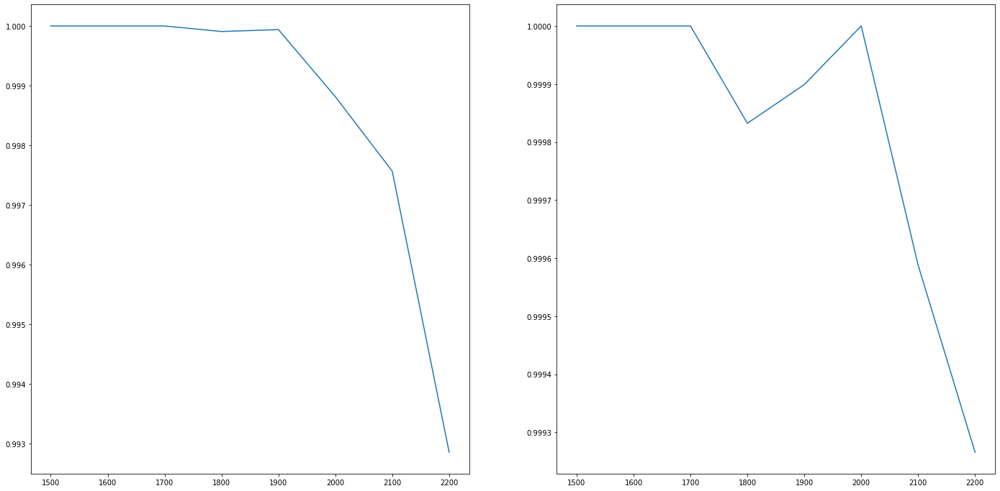

In [23]:
plt.figure(figsize=(24, 12))
plt.subplot(1, 2, 1)
plt.plot(100 * U, eff2)
plt.subplot(1, 2, 2)
plt.plot(100 * U, eff1)
plt.show()

>### Поиск

In [17]:
rdf = ROOT.RDataFrame('TD', 'data/point_2.root')
data = pd.DataFrame(rdf.AsNumpy())
I14 = [data['Par.I'][i][14] for i in range(data.shape[0])]
I15 = [data['Par.I'][i][15] for i in range(data.shape[0])]
pd.DataFrame({'I[14]': I14, 'I[15]': I15}).to_csv('point_2.csv'.format(i), index=False)

In [ ]:
data = pd.read_csv('point_2.csv')

In [18]:
hfile = gROOT.FindObject( 'data/point_2.root' )
hfile = TFile( 'data/point_2.root' )
c1 = TCanvas('h', 'h')
p = hfile.Get('TD')

In [19]:
c1.cd()
p.Draw('I[14]:I[15]>>(50,0,10000,50,0,10000)', 'T[15]>100 && T[14]>100')
%jsroot on
from ROOT import gROOT
gROOT.GetListOfCanvases().Draw()

In [ ]:
c1.cd()
p.Draw("log(I[15]/I[14]):T[15]-T[14]>>(50,-20,20,40,-4,4)", "I[15]+I[14]>30000 && I[15]>1000 && I[14]>1000 && T[15]>100 && T[14]>100", "color")
%jsroot on
from ROOT import gROOT
gROOT.GetListOfCanvases().Draw()

In [ ]:
c1.cd()
p.Draw("T[15]-T[14]>>(100,-20,20)", "I[15]+I[14]>30000 && I[15]>1000 && I[14]>1000 && T[15]>100 && T[14]>100")
%jsroot on
from ROOT import gROOT
gROOT.GetListOfCanvases().Draw()